# Religious Composition of Migration Flows

## Background: 

The period of 1990-2020 saw a large uptick in international migration, prompted by factors ranging from economic advancement to regime instability. These flows were not just of people and their possessions, but also of culture and ideologies. Specifically, the religious composition of migration flows is of great contemporary interest, as religion is a facet of identity that significantly impacts social cohesion and identity preservation in both incoming and outgoing countries. In this project, we analyze the religious composition of migrants over the period of 1990-2020 to identify trends. 

## Dataset: 

We used a dataset compiled by Pew Research that can be found at the following link: https://www.pewresearch.org/dataset/dataset-religious-composition-of-the-worlds-migrants-1990-2020/

While there have been other compelling efforts to gather "stocks" of international migrants, Pew's is the only dataset that compiles their religious composition  by drawing on census and survey data, including the World Values Survey, the European Social Survey, and Pew's own surveys. Migrant stock estimates were compiled from the UN Population Divisionm, which shows origin and destination countries of international migratns on an annual basis. A more detailed explanation of the dataset methodology can be found at the following link: https://www.pewresearch.org/religion/2024/08/19/religious-composition-migrants-methodology/#why-our-estimates-may-differ-from-other-sources

## Definitions: 

Migrant: The United Nations counts international migrants as people of any age who live outside their country (or in some cases, territory) of birth – regardless of their motives for migrating, their length of residence, or their legal status. In addition to naturalized citizens and permanent residents, the UN’s international migrant numbers include asylum-seekers and refugees, as well as people without official residence documents. The UN also includes some people who live in a country temporarily – like some students and guest workers – but it does not include short-term visitors like tourists, nor does it typically include military forces deployed abroad. 

Stocks vs Flows: Our analysis focuses on existing stocks of international migrants: all people who now live outside their birth country, no matter when they left. We do not estimate migration flows: how many people move across borders in any single year.


In [2]:
import pandas as pd

# Path to the uploaded file
file_path = 'Incoming and Outgoing Migrant Counts.csv'

# Step 1: Load the CSV file into a DataFrame
df = pd.read_csv(file_path)

# Step 2: Set the correct header row and remove unnecessary rows
df.columns = df.iloc[0]  # Set the first row as the header
df = df.iloc[1:]  # Remove the first row

# Step 3: Rename the columns for easier access
df.columns = ['Direction', 'Year', 'Country', 'Religion', 'Count', 'Percent', 'Region', 'Level', 'CountryCode']

# Step 4: Drop any completely empty rows
df = df.dropna(how='all')

# Step 5: Remove any rows where 'Year' or 'Country' is missing, as these are critical for analysis
df = df[df['Year'].notnull() & df['Country'].notnull()]

# Step 6: Clean the 'Count' column
# Extract only numeric characters from the 'Count' column
df['Count'] = df['Count'].replace('[^0-9.]', '', regex=True)  # Keep only numeric characters and dots
df['Count'] = pd.to_numeric(df['Count'], errors='coerce')  # Convert to float, setting non-numeric to NaN

# Step 7: Check for missing or invalid data in 'Count' column
if df['Count'].isnull().all():
    print("All values in the 'Count' column are invalid or missing. Please check the data.")
else:
    print("Data has been successfully loaded and cleaned.")
    print(f"Number of rows: {df.shape[0]}")
    print(f"Number of columns: {df.shape[1]}")
    print("Here's a preview of the first 5 rows of the cleaned data:")
    print(df.head())

Data has been successfully loaded and cleaned.
Number of rows: 26712
Number of columns: 9
Here's a preview of the first 5 rows of the cleaned data:
  Direction  Year       Country   Religion      Count Percent  Region Level  \
1  Incoming  1990  Global Total        All  152970000   100.0  Global     3   
2  Incoming  1990  Global Total   Buddhist    4590000     3.0  Global     3   
3  Incoming  1990  Global Total  Christian   72710000    47.5  Global     3   
4  Incoming  1990  Global Total      Hindu    9130000     6.0  Global     3   
5  Incoming  1990  Global Total        Jew    2340000     1.5  Global     3   

  CountryCode  
1        9999  
2        9999  
3        9999  
4        9999  
5        9999  


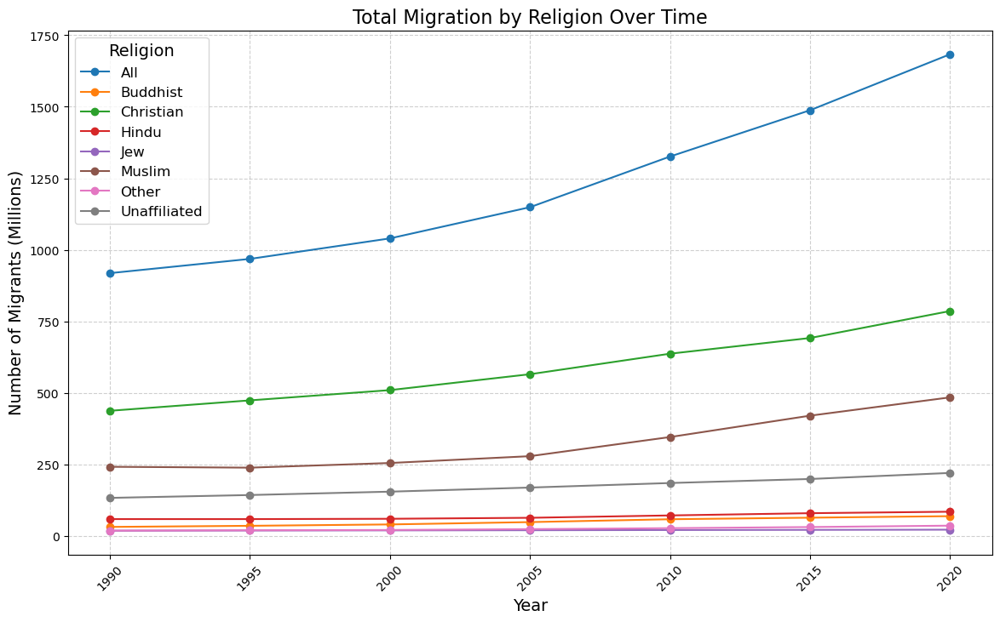

In [3]:
import matplotlib.pyplot as plt
import mplcursors
from matplotlib.cm import tab10
from matplotlib.ticker import MaxNLocator

# Aggregate total migration counts per year and religion
yearly_migration = df.groupby(['Year', 'Religion'])['Count'].sum().reset_index()

# Calculate year-over-year growth rates
yearly_migration['Growth Rate'] = yearly_migration.groupby('Religion')['Count'].pct_change() * 100

# Convert Count to millions
yearly_migration['Count'] = yearly_migration['Count'] / 1_000_000

# Initialize the plot
plt.figure(figsize=(14, 8))

# Generate a color palette
colors = plt.cm.tab10(range(len(yearly_migration['Religion'].unique())))

# Plot data for each religion
for idx, religion in enumerate(yearly_migration['Religion'].unique()):
    subset = yearly_migration[yearly_migration['Religion'] == religion]
    plt.plot(
        subset['Year'], subset['Count'], 
        marker='o', label=religion, color=colors[idx]
    )

# Add gridlines
plt.grid(True, linestyle='--', alpha=0.6)

# Add titles and labels
plt.title('Total Migration by Religion Over Time', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Migrants (Millions)', fontsize=14)

# Add a legend
plt.legend(title='Religion', fontsize=12, title_fontsize=14)

# Adjust x-axis ticks and ensure integer labels
plt.xticks(rotation=45)
plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))

# Highlight the maximum point with an annotation
max_value = yearly_migration['Count'].max()
max_row = yearly_migration[yearly_migration['Count'] == max_value]
max_year = int(max_row['Year'].values[0])
max_religion = max_row['Religion'].values[0]
plt.annotate(
    f'Max: {max_value:.1f}M ({max_religion})',
    xy=(max_year, max_value),
    xytext=(max_year - 5, max_value + 5),
    arrowprops=dict(facecolor='black', arrowstyle='->'),
    fontsize=12
)

# Add interactivity with mplcursors
mplcursors.cursor(hover=True)

# Save the plot
plt.savefig('migration_by_religion.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

We can see that overall migration has increased in absolute numbers by 80% between 1990-2020, but that much of the growth comes from migrations of Christians and Muslims, compared to other religious groups. An alternative view would be to compare migration growth rates across different religions, as seen below.

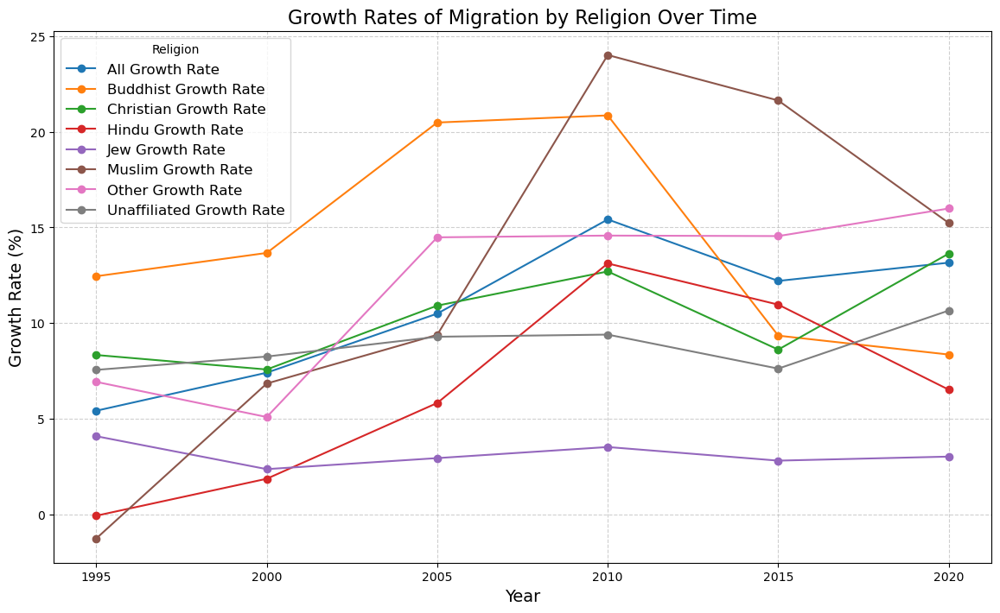

In [5]:
plt.figure(figsize=(14, 8))
for idx, religion in enumerate(yearly_migration['Religion'].unique()):
    subset = yearly_migration[yearly_migration['Religion'] == religion]
    plt.plot(subset['Year'], subset['Growth Rate'], marker='o', label=f"{religion} Growth Rate", color=colors[idx])

plt.title('Growth Rates of Migration by Religion Over Time', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Growth Rate (%)', fontsize=14)
plt.legend(title='Religion', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

A striking result is the spike in Muslim migration growth rate, which jumped in 2010 - presumably because of political upheaval from the Arab Spring, which caused widespread displacement. To examine the specific direction of these flows, we selected for Muslim religion and the year 2015 (assuming movements take some time to respond to political shocks) to get more granular insights.

As suspected, the top outgoing countries included Syria, Afghanistan, and Palestine, which were all areas affected by war and conflict between 2010-2015. Interestingly, India and Pakistan also make this list, though this can be understood as a reflection of the high number of overall migration from these countries that include a large number of Muslims.

We find that the top incoming destinations for Muslim migrants included Jordan, Turkey, and the United States, which makes sense given the refugee intake programs in these nations. 

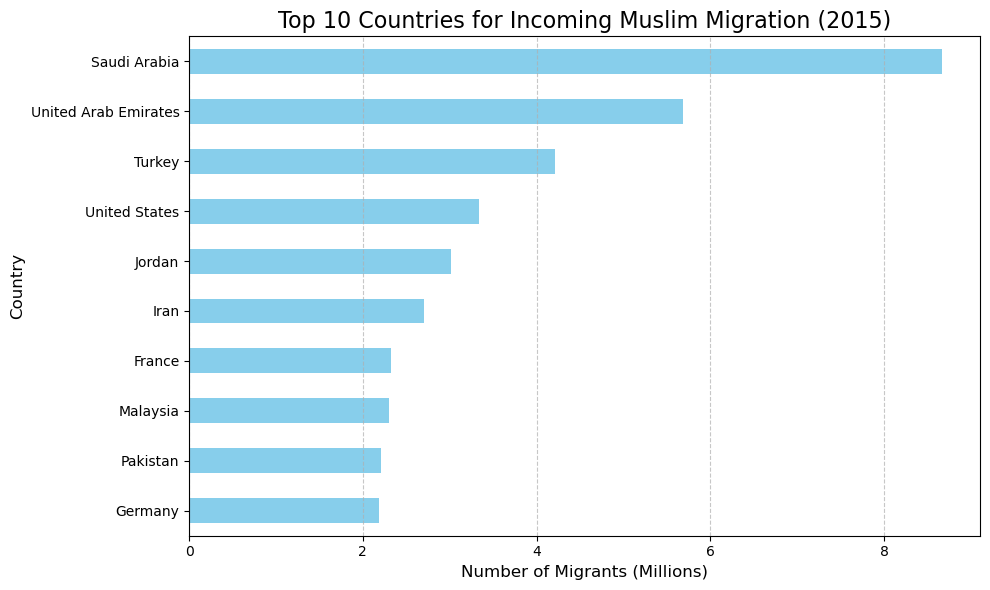

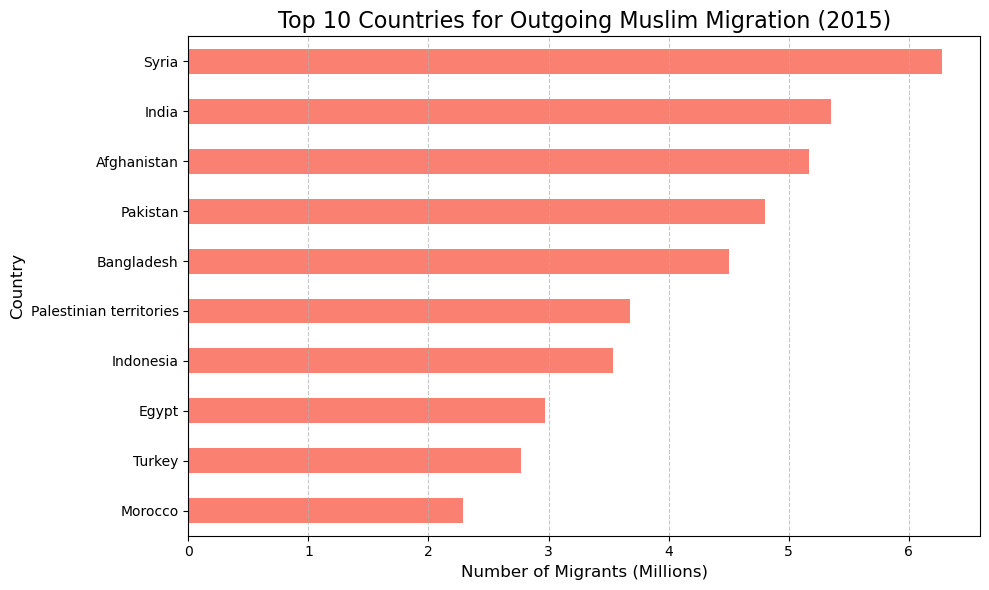

In [7]:
# Filter data for Muslims in the year 2010
muslims_2015 = df[
    (df['Year'] == '2015') & 
    (df['Religion'] == 'Muslim')
]

# Separate incoming and outgoing data
incoming_data = muslims_2015[muslims_2015['Direction'] == 'Incoming']
outgoing_data = muslims_2015[muslims_2015['Direction'] == 'Outgoing']

# Remove unnecessary rows (e.g., global totals or regions)
incoming_data = incoming_data[
    ~incoming_data['Country'].str.startswith('All') &
    (incoming_data['Country'] != 'Global Total')
]
outgoing_data = outgoing_data[
    ~outgoing_data['Country'].str.startswith('All') &
    (outgoing_data['Country'] != 'Global Total')
]

# Aggregate and get top 10 countries for each direction
top_incoming = incoming_data.groupby('Country')['Count'].sum().nlargest(10)
top_outgoing = outgoing_data.groupby('Country')['Count'].sum().nlargest(10)

# Convert counts to millions for readability
top_incoming = top_incoming / 1_000_000
top_outgoing = top_outgoing / 1_000_000

# Plot incoming migration
plt.figure(figsize=(10, 6))
top_incoming.sort_values().plot(kind='barh', color='skyblue')
plt.title('Top 10 Countries for Incoming Muslim Migration (2015)', fontsize=16)
plt.xlabel('Number of Migrants (Millions)', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Plot outgoing migration
plt.figure(figsize=(10, 6))
top_outgoing.sort_values().plot(kind='barh', color='salmon')
plt.title('Top 10 Countries for Outgoing Muslim Migration (2015)', fontsize=16)
plt.xlabel('Number of Migrants (Millions)', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


Continuing the analysis, we ran the same test for other religions across top incoming and outgoing destinations to see if there were any further insights.

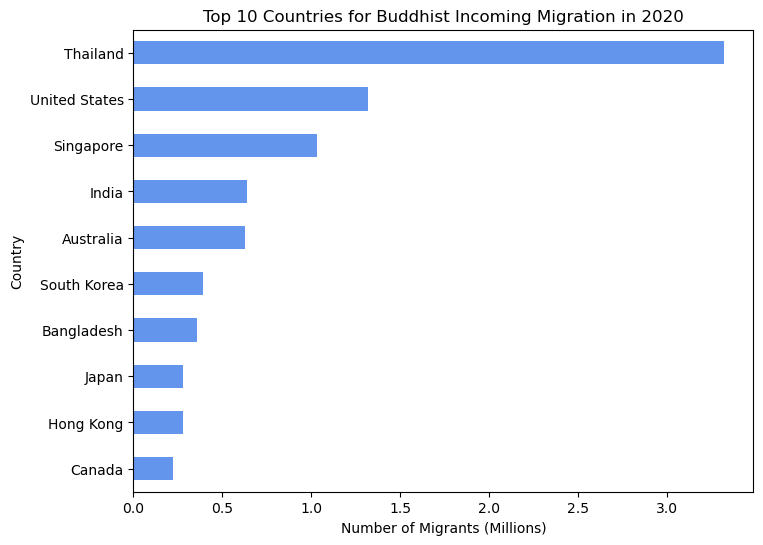

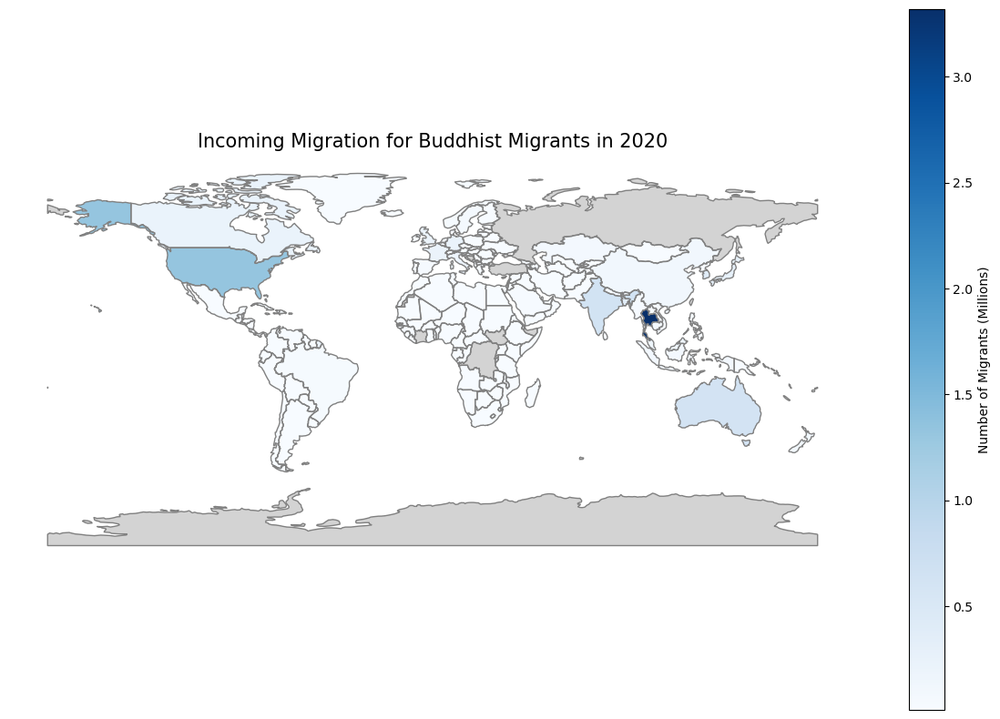

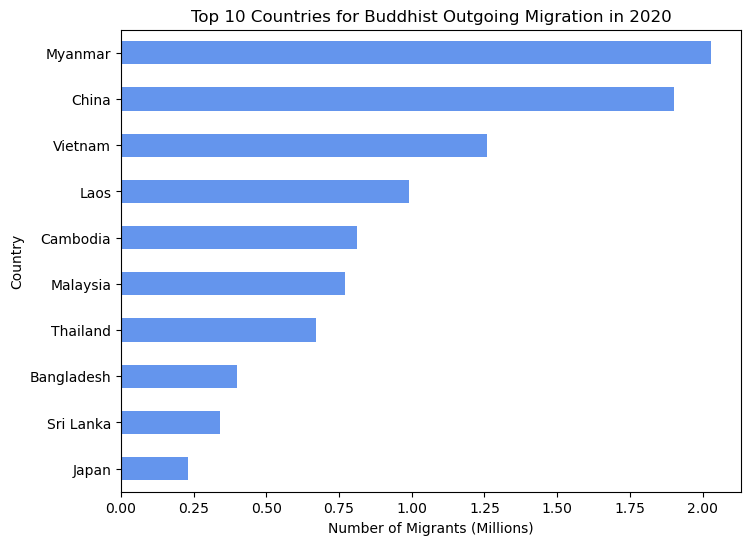

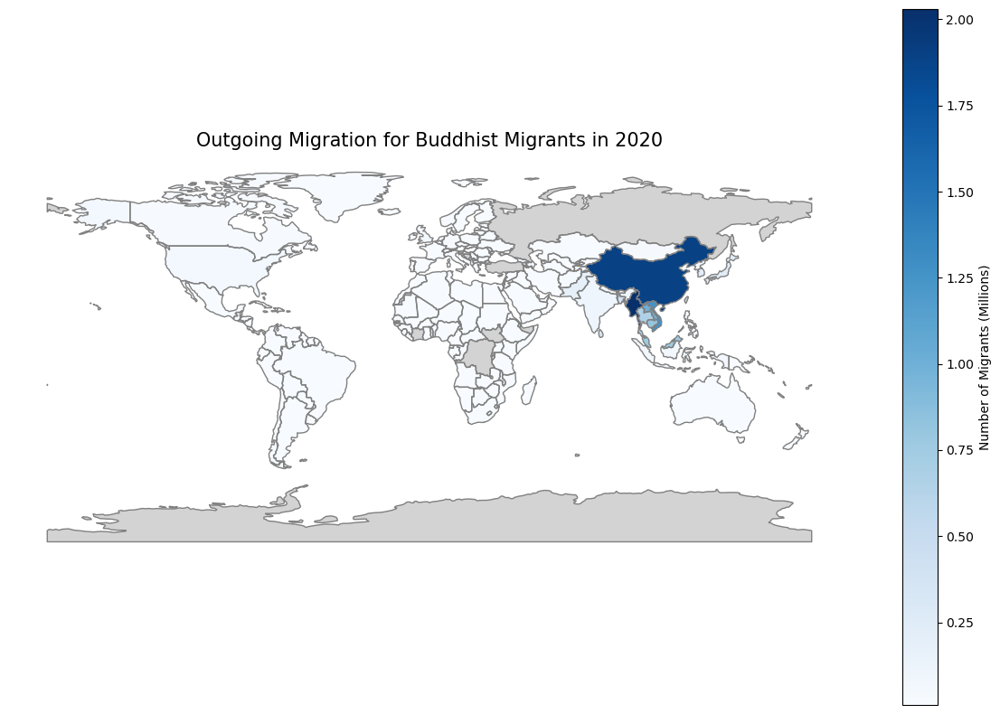

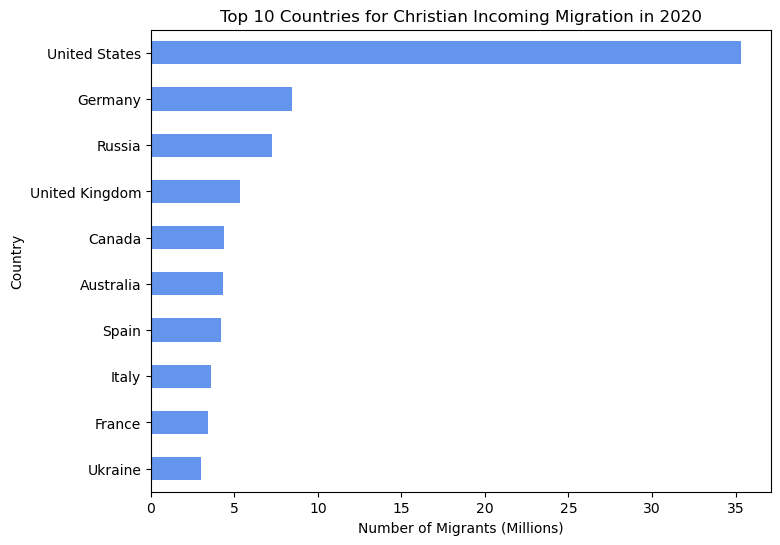

...

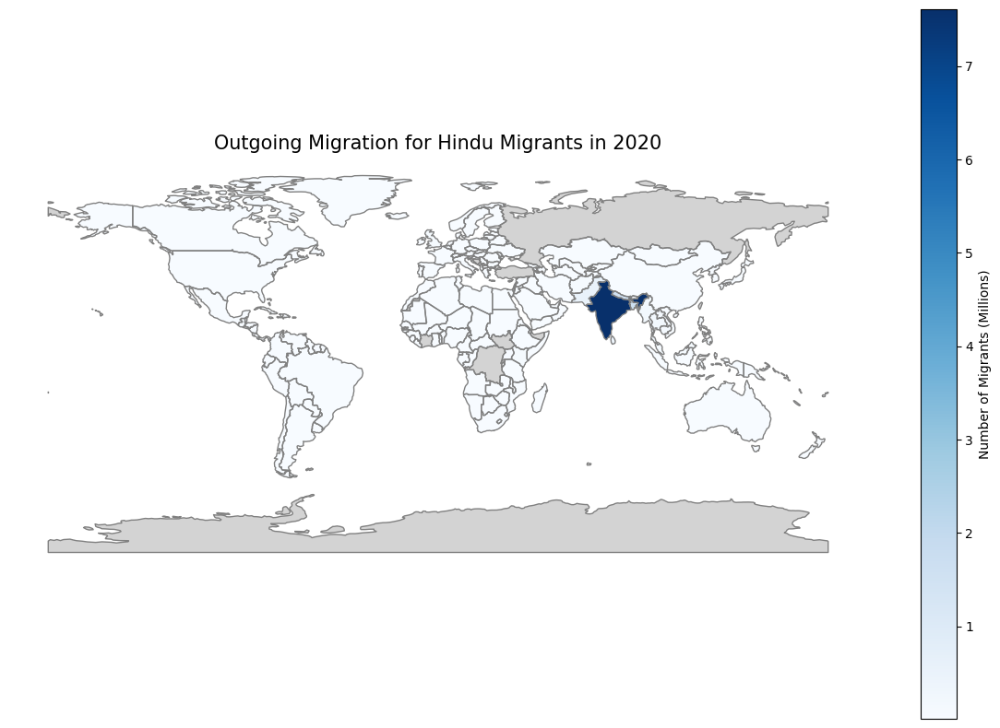

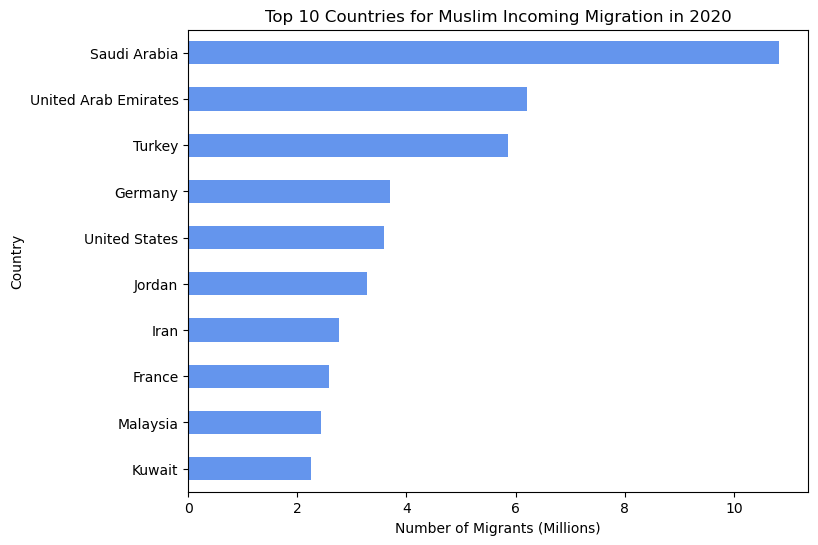

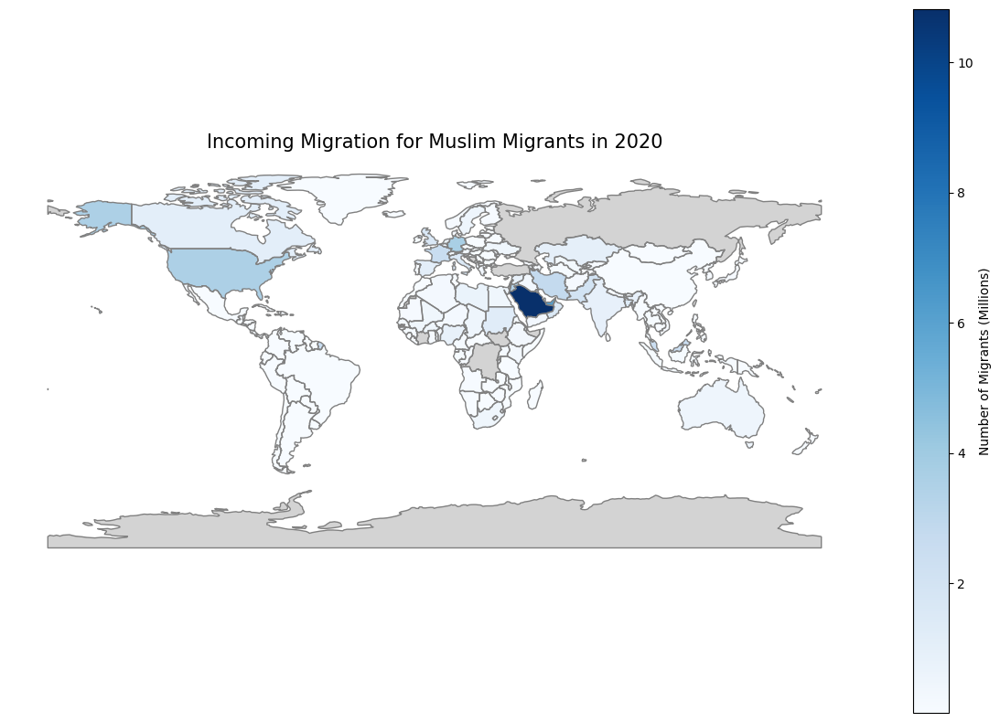

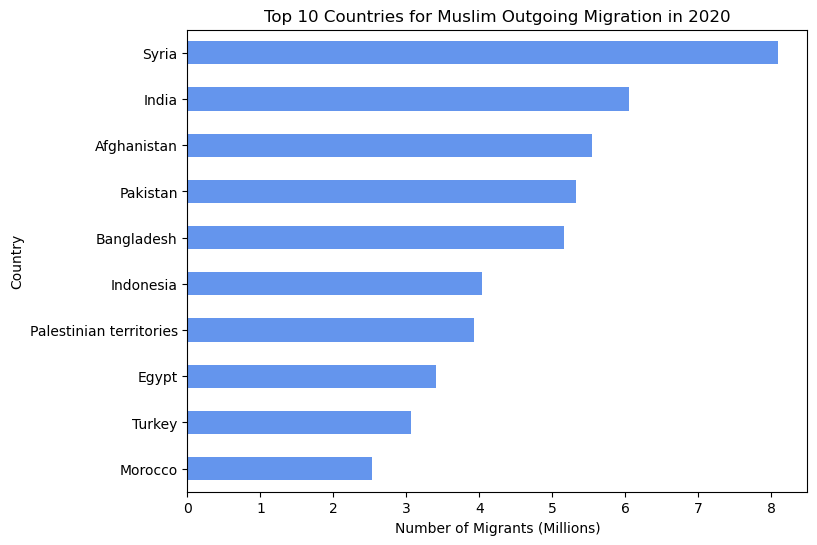

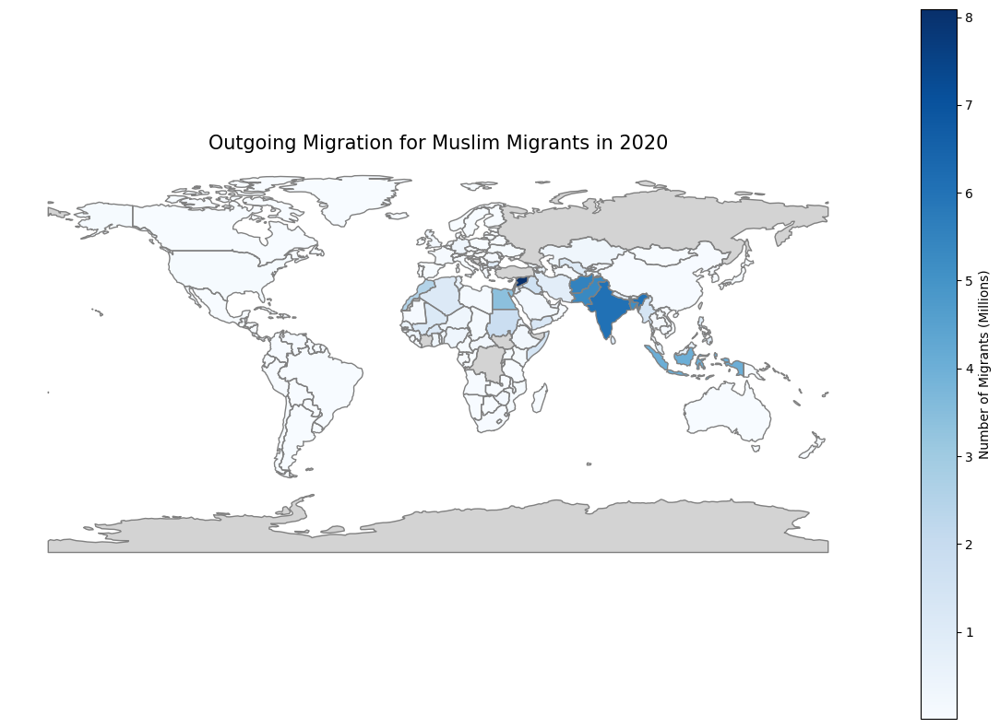

In [9]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import pycountry

# Function to plot top 10 countries as bar charts
def plot_top_countries(df, years, direction, religion):
    """
    Plots the top 10 countries for migration based on direction and religion.
    Tries multiple years if no data is found for the preferred year.
    """
    for year in years:
        top_countries = df[
            (df['Direction'] == direction) &
            (df['Year'] == str(year)) &
            (df['Religion'] == religion)
        ]

        top_countries = top_countries[
            ~top_countries['Country'].str.startswith('All') & 
            (top_countries['Country'] != 'Global Total')
        ]

        if not top_countries.empty:
            top_10_countries = top_countries.groupby('Country')['Count'].sum().nlargest(10)

            if not top_10_countries.empty:
                top_10_countries = top_10_countries / 1_000_000  # Convert to millions
                top_10_countries = top_10_countries.sort_values(ascending=True)

                fig, ax = plt.subplots(figsize=(8, 6))
                top_10_countries.plot(kind='barh', color='cornflowerblue', ax=ax)
                plt.title(f'Top 10 Countries for {religion} {direction} Migration in {year}')
                plt.xlabel('Number of Migrants (Millions)')
                plt.ylabel('Country')
                plt.show()
                return  # Exit after successfully plotting
    print(f"No data available for {religion} {direction} migration in {years}.")

# Function to plot migration trends on a world map
def plot_migration_map(df, years, direction, religion, shapefile_path):
    """
    Plots migration data on a world map using GeoPandas.
    Tries multiple years if no data is found for the preferred year.
    """
    for year in years:
        migration_data = df[
            (df['Direction'] == direction) &
            (df['Year'] == str(year)) &
            (df['Religion'] == religion)
        ]

        migration_data = migration_data[
            ~migration_data['Country'].str.startswith('All') & 
            (migration_data['Country'] != 'Global Total')
        ]

        migration_data = migration_data.groupby('Country')['Count'].sum().reset_index()

        if not migration_data.empty:
            def get_country_code(name):
                try:
                    return pycountry.countries.lookup(name).alpha_3
                except:
                    return None

            migration_data['ISO_A3'] = migration_data['Country'].apply(get_country_code)
            migration_data = migration_data.dropna(subset=['ISO_A3'])

            world = gpd.read_file(shapefile_path)
            world = world.merge(migration_data, left_on='ADM0_A3', right_on='ISO_A3', how='left')

            # Convert Counts to Millions
            world['Count'] = world['Count'] / 1_000_000  # Convert to millions

            fig, ax = plt.subplots(1, 1, figsize=(15, 10))
            world.boundary.plot(ax=ax, linewidth=1, color="gray")  # Country boundaries
            world.plot(column='Count', cmap='Blues', legend=True, ax=ax, 
                       legend_kwds={'label': "Number of Migrants (Millions)"},
                       missing_kwds={"color": "lightgrey", "label": "No data"})

            plt.title(f'{direction} Migration for {religion} Migrants in {year}', fontsize=15)
            plt.axis('off')
            plt.show()
            return  # Exit after successfully plotting
    print(f"No data available for {religion} {direction} migration in {years}.")

# Main Script
primary_year = 2020
backup_years = [2018, 2015, 2010, 2005]  # Backup years to try if no data is available
all_years = [primary_year] + backup_years  # List of years to try

shapefile_path = 'ne_110m_admin_0_countries.shp'

# List of religions to visualize (Jewish has been removed)
religions = ['Buddhist', 'Christian', 'Hindu', 'Muslim']

# Loop through each religion and visualize incoming and outgoing migration
for religion_of_interest in religions:
    # Incoming Migration
    plot_top_countries(df, all_years, 'Incoming', religion_of_interest)
    plot_migration_map(df, all_years, 'Incoming', religion_of_interest, shapefile_path)

    # Outgoing Migration
    plot_top_countries(df, all_years, 'Outgoing', religion_of_interest)
    plot_migration_map(df, all_years, 'Outgoing', religion_of_interest, shapefile_path)

Looking at Buddhist migrations in 2020, we note that there seems to be a net movement from Myanmar, China, and Vietnam toward, Thailand, the United States, and Singapore. Geographically, the Southeast Asian flows make sense since Myanmar, Thailand, and Vietnam share borders and there have been increased flows towards Thailand in search of economic opportunity, as with Singapore. Myanmar's internal conflicts between ethnic groups (preceding the more recent, widespread civil war) was also likely a factor.

Next, we look at the overall migration patterns between countries in the form of heatmap for a zoomed out picture of the movements across the entire time period 1990-2020: 

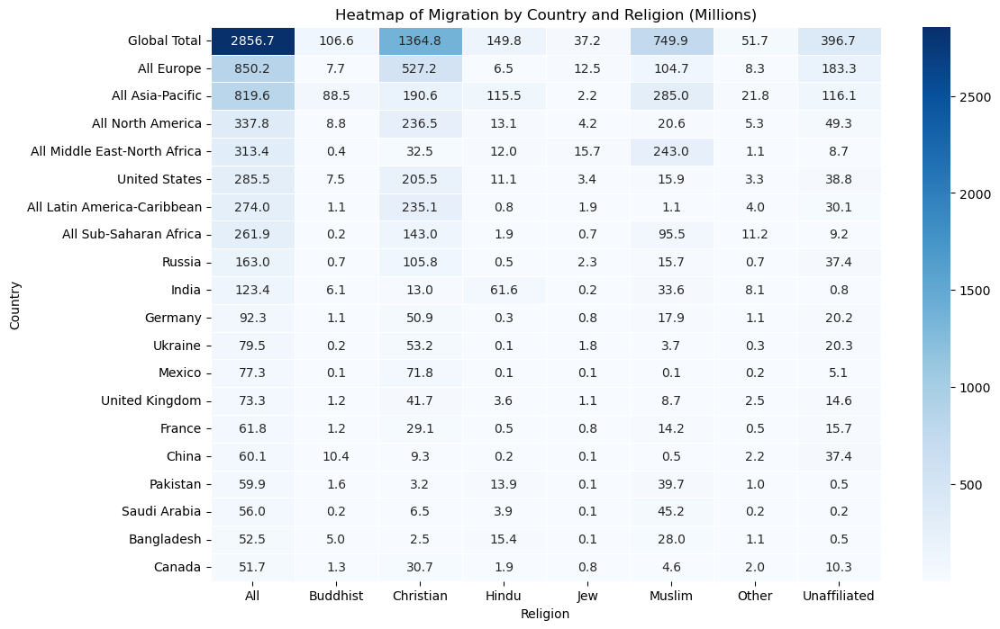

In [11]:
import seaborn as sns

# Create a pivot table of migration counts by religion and country
pivot_table = df.pivot_table(index='Country', columns='Religion', values='Count', aggfunc='sum').fillna(0)
pivot_table = pivot_table / 1_000_000  # Convert to millions

# Filter top 20 countries by total migration
top_20_countries = pivot_table.sum(axis=1).nlargest(20).index
pivot_table = pivot_table.loc[top_20_countries]

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(pivot_table, annot=True, fmt=".1f", cmap='Blues', linewidths=0.5)
plt.title('Heatmap of Migration by Country and Religion (Millions)')
plt.ylabel('Country')
plt.xlabel('Religion')
plt.show()

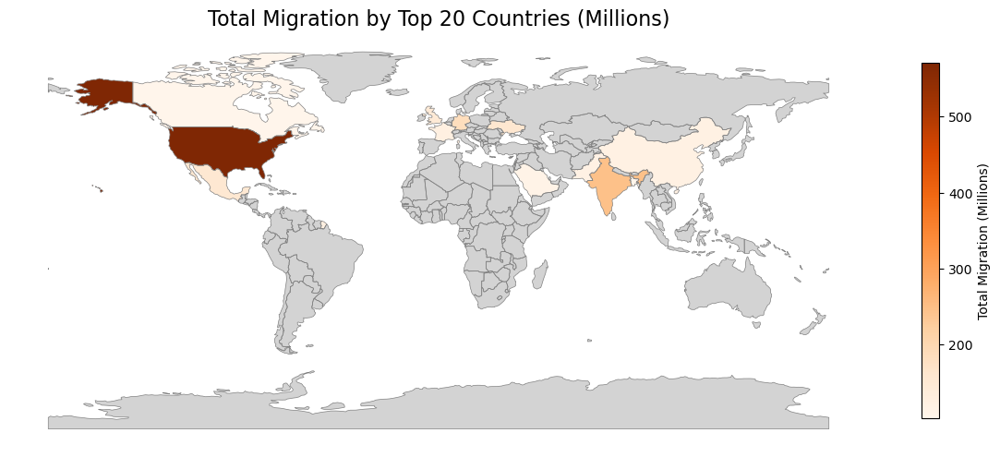

In [12]:
shapefile_path = 'ne_110m_admin_0_countries.shp'
  
# Prepare migration data
pivot_table = df.pivot_table(index='Country', columns='Religion', values='Count', aggfunc='sum').fillna(0)
pivot_table = pivot_table / 1_000_000  # Convert to millions

# Filter top 20 countries by total migration
top_20_countries = pivot_table.sum(axis=1).nlargest(20).index
migration_data = pivot_table.loc[top_20_countries].sum(axis=1).reset_index()
migration_data.columns = ['Country', 'Total_Migration']

# Ensure it's a fresh copy of the data (avoiding SettingWithCopyWarning)
migration_data = migration_data.copy()

# Function to get ISO codes for country names
def get_country_code(name):
    try:
        return pycountry.countries.lookup(name).alpha_3
    except:
        return None

# Add ISO_A3 codes safely using .loc
migration_data.loc[:, 'ISO_A3'] = migration_data['Country'].apply(get_country_code)

# Drop rows with missing ISO codes
migration_data = migration_data.dropna(subset=['ISO_A3'])

# Add ISO_A3 codes to the migration data
migration_data['ISO_A3'] = migration_data['Country'].apply(get_country_code)
migration_data = migration_data.dropna(subset=['ISO_A3'])

world = gpd.read_file(shapefile_path)
world = world.merge(migration_data, left_on='ADM0_A3', right_on='ISO_A3', how='left')


# Plot the world map for top 20 countries
fig, ax = plt.subplots(figsize=(15, 10))
world.boundary.plot(ax=ax, linewidth=0.5, color="gray")  # Country boundaries
world.plot(column='Total_Migration', cmap='Oranges', linewidth=0.5, ax=ax,
               legend=True, missing_kwds={'color': 'lightgrey', 'label': 'No data'},
               legend_kwds={'label': "Total Migration (Millions)", 'shrink': 0.5})

# Add title and styling
plt.title('Total Migration by Top 20 Countries (Millions)', fontsize=16)
plt.axis('off')  
plt.show()

The graphic above has regions greyed out due to mapping issues between Natural Earth's country name specifications versus our raw data. A refined version of this would have us map out each of the countries with the help of a dictionary to have a fully color-scaled map. 

Images for 1990, 2000, 2010, and 2020 have been created and saved.


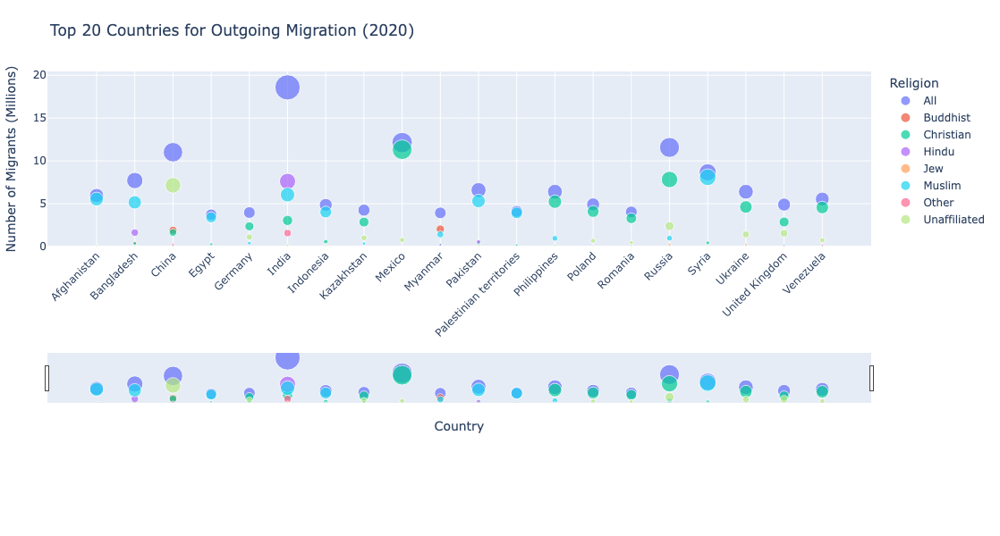

In [14]:
import plotly.express as px

# Define the years to visualize
years = [1990, 2000, 2010, 2020]

# Loop through each year and generate the scatter plot
for year in years:
    # Filter for outgoing migration data for the current year
    scatter_data = df[
        (df['Direction'] == 'Outgoing') & 
        (df['Year'] == str(year))
    ]

    # Exclude rows with "Global Total" or aggregated categories
    scatter_data = scatter_data[~scatter_data['Country'].str.contains("Global|All", case=False)]

    # Group by country and religion, and sum the counts
    scatter_summary = scatter_data.groupby(['Country', 'Religion'])['Count'].sum().reset_index()

    # Sort countries by total count and keep top 20
    top_countries = scatter_summary.groupby('Country')['Count'].sum().nlargest(20).index
    scatter_summary = scatter_summary[scatter_summary['Country'].isin(top_countries)]

    # Convert counts to millions for easier readability
    scatter_summary['Count'] = scatter_summary['Count'] / 1_000_000

    # Create the scatter plot
    fig = px.scatter(
        scatter_summary, 
        x="Country", 
        y="Count", 
        color="Religion",
        size="Count", 
        title=f"Top 20 Countries for Outgoing Migration ({year})", 
        labels={"Count": "Number of Migrants (Millions)", "Country": "Country"},
        template="plotly",
        hover_data=["Religion", "Count"]
    )

    # Update layout to make the x-axis scrollable
    fig.update_layout(
        width=1200,  # Figure width
        height=600,  # Figure height
        xaxis=dict(
            tickangle=-45,
            title="Country",
            title_standoff=10,
            showgrid=True,
            rangeslider=dict(visible=True),  # Add scrollable range slider
            fixedrange=False
        ),
        yaxis=dict(
            title="Number of Migrants (Millions)",
            range=[0, scatter_summary['Count'].max() * 1.1]
        ),
        margin=dict(l=40, r=40, t=80, b=150)  # Add margins
    )

    # Save the plot as an image for the current year
    fig.write_image(f"outgoing_migration_{year}.png")

# Print message when done
print("Images for 1990, 2000, 2010, and 2020 have been created and saved.")
fig.show()

To compare this graphic over the years, we use imageio to create a gif that can be played by running the code below: 

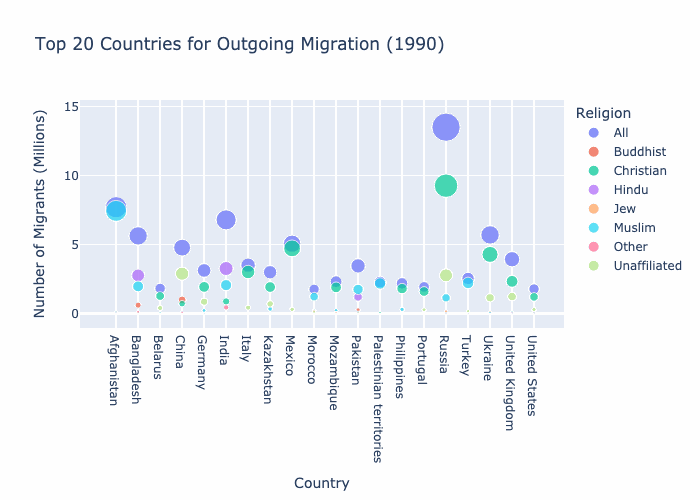

In [16]:
import imageio.v2 as imageio  # Explicitly use imageio.v2
import os
import plotly.express as px  # Import plotly express
import pandas as pd
from IPython.display import Image, display  # Import display tools to show the GIF inline

# Define the years to plot
years = [1990, 2000, 2005, 2010, 2015, 2020]

# Ensure Year column is clean
df['Year'] = df['Year'].astype(str).str.strip()

# Directory to save images
output_dir = "migration_images"
os.makedirs(output_dir, exist_ok=True)

# Generate images for each year
image_files = []
for year in years:
    scatter_data = df[
        (df['Direction'] == 'Outgoing') & 
        (df['Year'] == str(year))
    ]
    scatter_data = scatter_data[~scatter_data['Country'].str.contains("Global|All", case=False)]
    scatter_summary = scatter_data.groupby(['Country', 'Religion'])['Count'].sum().reset_index()
    top_countries = scatter_summary.groupby('Country')['Count'].sum().nlargest(20).index
    scatter_summary = scatter_summary[scatter_summary['Country'].isin(top_countries)]
    scatter_summary['Count'] = scatter_summary['Count'] / 1_000_000

    # Create the scatter plot
    fig = px.scatter(
        scatter_summary, 
        x="Country", 
        y="Count", 
        color="Religion",
        size="Count", 
        title=f"Top 20 Countries for Outgoing Migration ({year})", 
        labels={"Count": "Number of Migrants (Millions)", "Country": "Country"},
        template="plotly",
        hover_data=["Religion", "Count"]
    )
    
    # Save the image temporarily
    image_path = os.path.join(output_dir, f"scatter_migration_{year}.png")
    fig.write_image(image_path)
    image_files.append(image_path)

# Combine images into a GIF
output_gif = "migration_timelapse_inline.gif"
fps = 1  # 1 frame per second
with imageio.get_writer(output_gif, mode='I', fps=fps) as writer:
    for image_file in image_files:
        writer.append_data(imageio.imread(image_file))

# Display the GIF inline
with open(output_gif, "rb") as file:
    display(Image(file.read()))

When we look at the flows across the entire time period with the gif above, another fascinating result is that the total stock of Hindu migrants from India living around the world increased from 9.1 million in 1990 to 13.5 million in 2020 (up 48%).  While Hindus have  made up between 5% and 6% of the international migrant population during these decades, their regional patterns have changed considerably. In 1990,over 80% of Hindu immigrants moved within the Asia-Pacific, but we see major upticks in movements of Hindus from India to the Middle East during the 2000-2020 period. Specifically, the Persian Gulf countries of Qatar, UAE and Saudi Arabia see big increases, as well as North America.

We should also take a moment to note that we can use the power of Python to uncover unusual patterns—or even errors—in the dataset. Take a look at the graphs below.

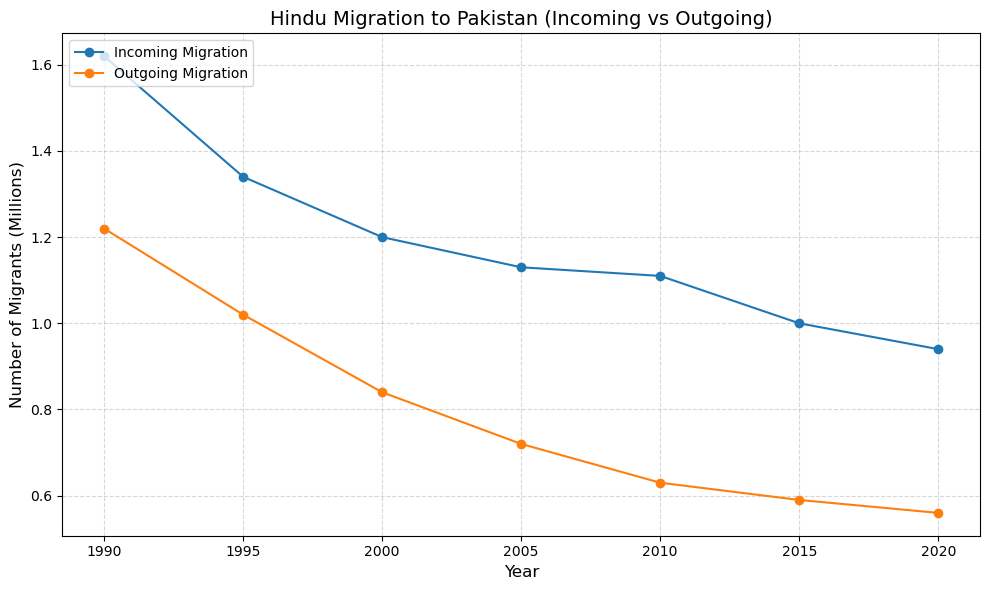

In [19]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter data for Hindu migration to Pakistan
hindu_pakistan = df[
    (df['Religion'] == 'Hindu') &
    (df['Country'] == 'Pakistan')
]

# Group by year and direction, summing up the migration counts
hindu_pakistan_summary = hindu_pakistan.groupby(['Year', 'Direction'])['Count'].sum().reset_index()

# Convert 'Year' to numeric for proper plotting
hindu_pakistan_summary['Year'] = pd.to_numeric(hindu_pakistan_summary['Year'], errors='coerce')

# Pivot the data for easier plotting (separate Incoming and Outgoing)
pivot_data = hindu_pakistan_summary.pivot(index='Year', columns='Direction', values='Count').fillna(0)

# Convert counts to millions for readability
pivot_data = pivot_data / 1_000_000

# Plot incoming and outgoing migration
plt.figure(figsize=(10, 6))

# Plot Incoming Migration
plt.plot(pivot_data.index, pivot_data['Incoming'], label='Incoming Migration', marker='o')

# Plot Outgoing Migration
plt.plot(pivot_data.index, pivot_data['Outgoing'], label='Outgoing Migration', marker='o')

# Add titles and labels
plt.title('Hindu Migration to Pakistan (Incoming vs Outgoing)', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Number of Migrants (Millions)', fontsize=12)

# Customize legend
plt.legend(loc='upper left')

# Add grid and display plot
plt.grid(visible=True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

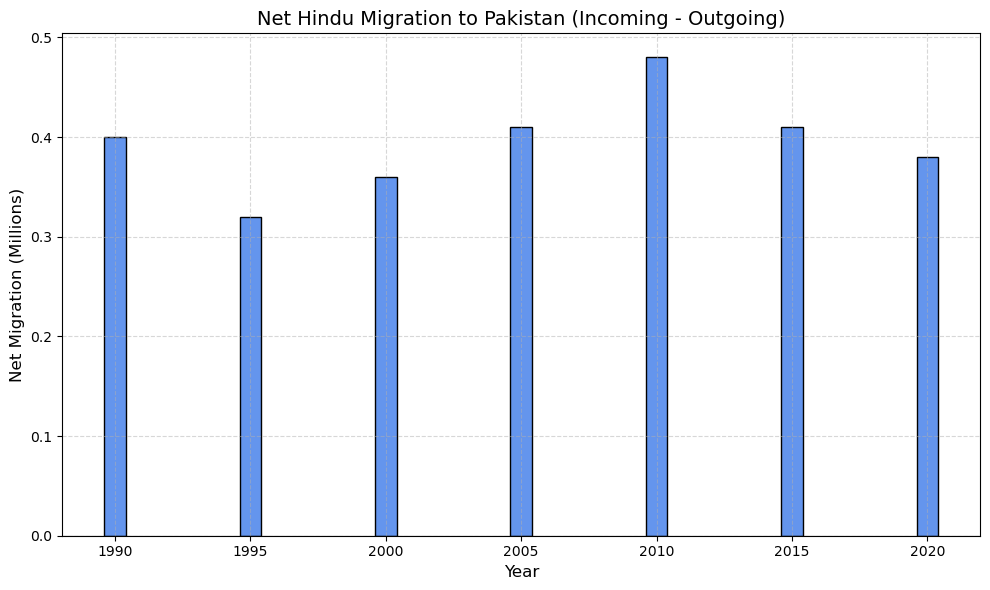

In [20]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter data for Hindu migration to Pakistan
hindu_pakistan = df[
    (df['Religion'] == 'Hindu') &
    (df['Country'] == 'Pakistan')
]

# Group by year and direction, summing the migration counts
hindu_pakistan_summary = hindu_pakistan.groupby(['Year', 'Direction'])['Count'].sum().reset_index()

# Convert 'Year' to numeric for sorting and plotting
hindu_pakistan_summary['Year'] = pd.to_numeric(hindu_pakistan_summary['Year'], errors='coerce')

# Pivot the data to calculate net migration (Incoming - Outgoing)
pivot_data = hindu_pakistan_summary.pivot(index='Year', columns='Direction', values='Count').fillna(0)
pivot_data['Net Migration'] = pivot_data['Incoming'] - pivot_data['Outgoing']

# Convert counts to millions for better readability
pivot_data['Net Migration'] = pivot_data['Net Migration'] / 1_000_000

# Plot the net migration as a bar chart
plt.figure(figsize=(10, 6))

# Bar plot
plt.bar(pivot_data.index, pivot_data['Net Migration'], color=['cornflowerblue'], edgecolor='black')

# Add labels and title
plt.title('Net Hindu Migration to Pakistan (Incoming - Outgoing)', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Net Migration (Millions)', fontsize=12)

# Highlight years with positive and negative net migration
plt.axhline(0, color='black', linewidth=0.8)  # Horizontal line at 0

# Add grid for clarity
plt.grid(visible=True, linestyle='--', alpha=0.5)

# Display the chart
plt.tight_layout()
plt.show()

The graphs above indicate that Hindu migration to Pakistan outpaced Hindu migration from the country every year on record. In addition to being counterintuitive (given Pakistan's well-earned reputation as a dangerous home for its Hindu minority), this trend appears to be uncorroborated. English media sources, for example, have not reported that Hindus are migrating to Pakistan in significant numbers, let alone in numbers large enough to counteract the outflow. Identifying the source of this error would require digging deeper into Pew's methodology, which is more than we can do with code alone, but Python enabled us to spotlight this potential issue with statistics. A logical next step, then, would be to contact Pew to inform its researchers that they might have made an error.

But before we take Pew to task (after getting an H for our amazing final project, no doubt), let's make some more maps. These maps will be unique, however, in that they'll visualize the migration flows we've been discussing.

In [23]:
import os
import pandas as pd
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

# Predefined coordinates for regions
# Note: These coordinates were independently assigned by ChatGPT as approximate centroids for the regions.
REGION_COORDINATES = {
    'All Asia-Pacific': (10, 120),
    'All Europe': (54, 15),
    'All Latin America-Caribbean': (-10, -60),
    'All Middle East-North Africa': (25, 40),
    'All North America': (45, -100),
    'All Sub-Saharan Africa': (0, 20),
}

def load_unique_countries(file_path):
    """
    Load unique country and region names from the migration dataset.

    Args:
        file_path (str): Path to the migration dataset CSV file.

    Returns:
        list: List of unique country/region names excluding "Global" totals.
    """
    df = pd.read_csv(file_path, skiprows=1)
    df.columns = ['Direction', 'Year', 'Country', 'Religion', 'Count', 'Percent', 'Region', 'Level', 'CountryCode']
    countries = df['Country'].dropna().unique()
    countries = [c for c in countries if not c.startswith('Global')]
    return countries

def save_predefined_regions(output_file):
    """
    Save predefined region coordinates directly to the coordinates file.

    Args:
        output_file (str): Path to save the predefined region coordinates.
    """
    region_coords = pd.DataFrame(
        [(region, lat, lon) for region, (lat, lon) in REGION_COORDINATES.items()],
        columns=['Country', 'Latitude', 'Longitude']
    )
    region_coords.to_csv(output_file, index=False)
    print("Predefined region coordinates saved to CSV.")

def fetch_coordinates(countries, output_file):
    """
    Fetch latitude and longitude coordinates for countries, skipping predefined regions.

    Args:
        countries (list): List of country/region names.
        output_file (str): Path to save the combined coordinates CSV file.

    Returns:
        None: Saves a CSV file with country/region names and their corresponding coordinates.
    """
    # Initialize geolocator with timeout and retry logic
    geolocator = Nominatim(user_agent="country_coordinates_generator", timeout=5)
    geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1, max_retries=3)
    
    # Load existing coordinates
    if os.path.exists(output_file):
        combined_coords = pd.read_csv(output_file)
    else:
        combined_coords = pd.DataFrame(columns=['Country', 'Latitude', 'Longitude'])

    existing_countries = combined_coords['Country'].tolist()

    new_data = []

    # Fetch coordinates for countries not in predefined regions
    for country in countries:
        if country in REGION_COORDINATES:
            print(f"Skipping predefined region: {country}")
            continue  # Skip predefined regions already added

        if country in existing_countries:
            print(f"Using cached coordinates for {country}")
            continue

        try:
            location = geocode(country)
            if location:
                print(f"Fetched coordinates for {country}: {location.latitude}, {location.longitude}")
                new_data.append((country, location.latitude, location.longitude))
            else:
                print(f"Coordinates not found for {country}")
        except Exception as e:
            print(f"Error fetching coordinates for {country}: {e}")
    
    # Append newly fetched coordinates
    new_coords = pd.DataFrame(new_data, columns=['Country', 'Latitude', 'Longitude'])
    combined_coords = pd.concat([combined_coords, new_coords], ignore_index=True)
    combined_coords.to_csv(output_file, index=False)
    print(f"Coordinates updated and saved to {output_file}")

def main():
    """
    Main function to ensure predefined regions are saved and fetch remaining coordinates.
    """
    file_path = 'Incoming and Outgoing Migrant Counts.csv'  # Migration data file
    output_file = 'country_coordinates.csv'  # Output file for coordinates

    # Save predefined regions first
    if not os.path.exists(output_file):
        save_predefined_regions(output_file)

    # Load countries and fetch coordinates
    countries = load_unique_countries(file_path)
    print(f"Found {len(countries)} unique countries/regions.")
    fetch_coordinates(countries, output_file)

if __name__ == "__main__":
    main()

Predefined region coordinates saved to CSV.
Found 238 unique countries/regions.
Skipping predefined region: All Asia-Pacific
Skipping predefined region: All Europe
Skipping predefined region: All Latin America-Caribbean
Skipping predefined region: All Middle East-North Africa
Skipping predefined region: All North America
Skipping predefined region: All Sub-Saharan Africa
Fetched coordinates for Afghanistan: 33.7680065, 66.2385139
Fetched coordinates for Albania: 5.7587654, -73.9151617
Fetched coordinates for Algeria: 28.0000272, 2.9999825
Fetched coordinates for American Samoa: -14.297124, -170.7131481
Fetched coordinates for Andorra: 42.5407167, 1.5732033
Fetched coordinates for Angola: -11.8775768, 17.5691241
Fetched coordinates for Antigua and Barbuda: 17.2234721, -61.9554608
Fetched coordinates for Azerbaijan: 40.3936294, 47.7872508
Fetched coordinates for Argentina: -34.9964963, -64.9672817
Fetched coordinates for Australia: -24.7761086, 134.755
Fetched coordinates for Austria: 47

Generating map for Incoming flows in 1990...


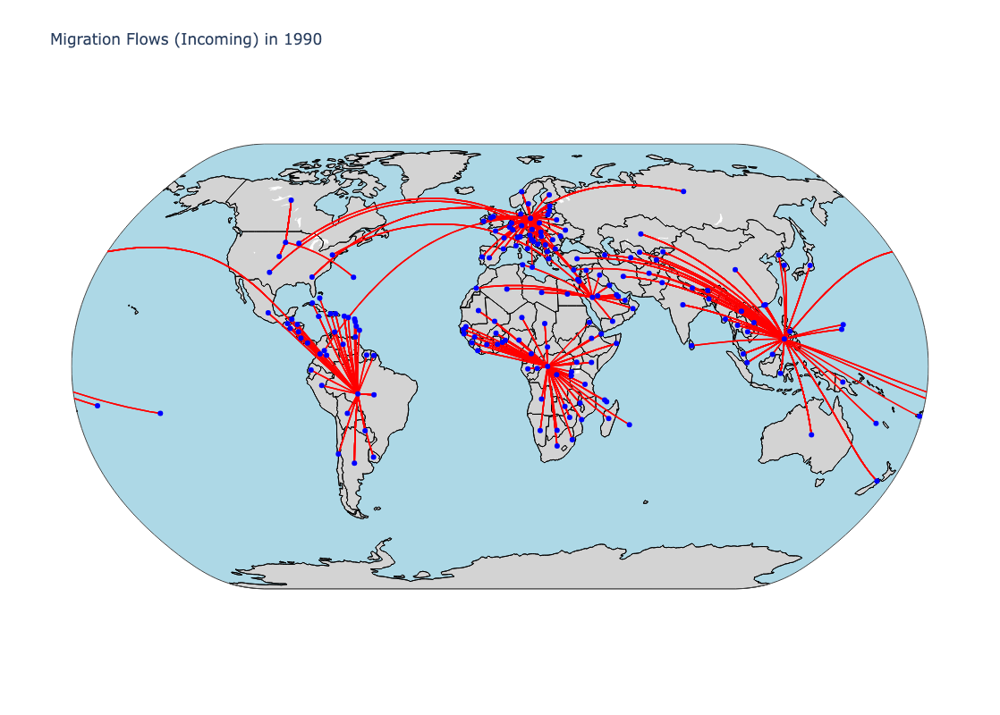

Generating map for Outgoing flows in 1990...


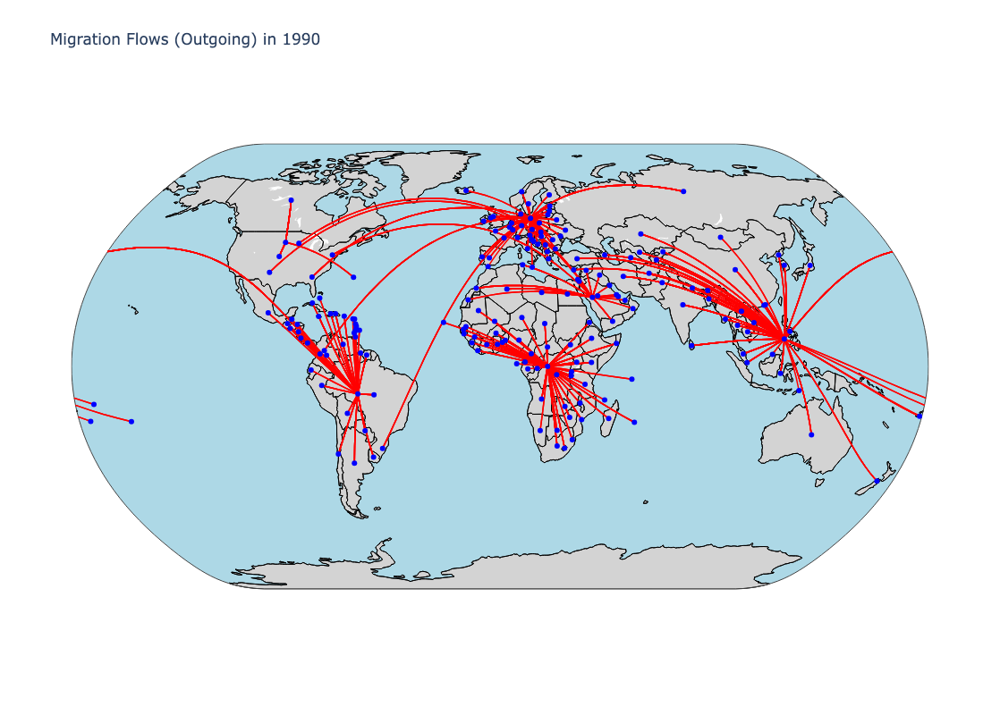

Generating map for Incoming flows in 1995...


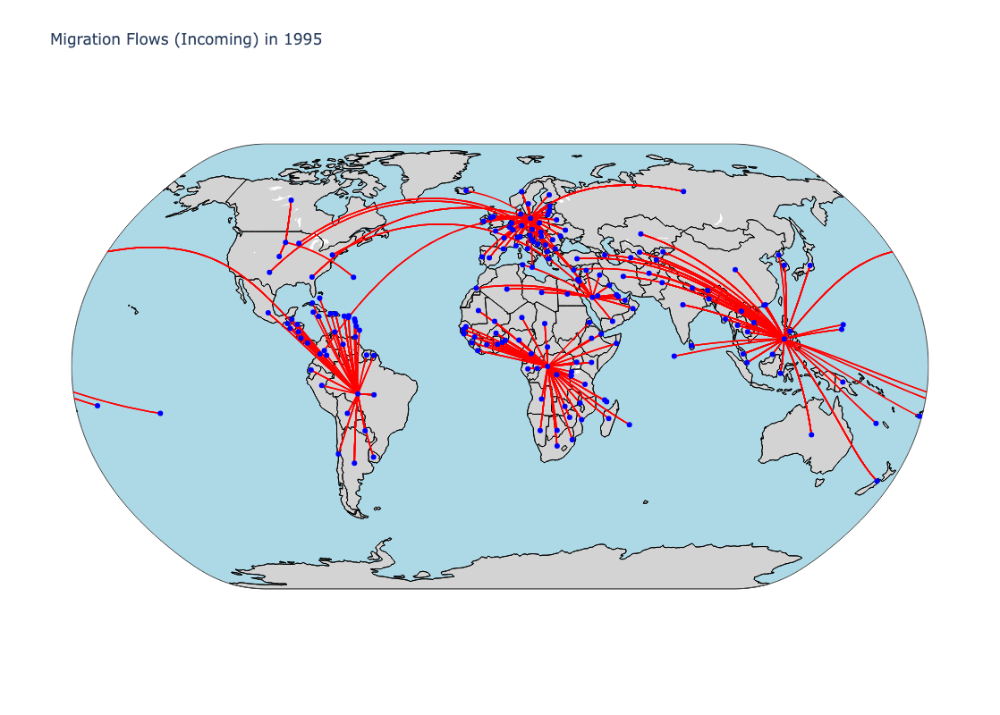

Generating map for Outgoing flows in 1995...


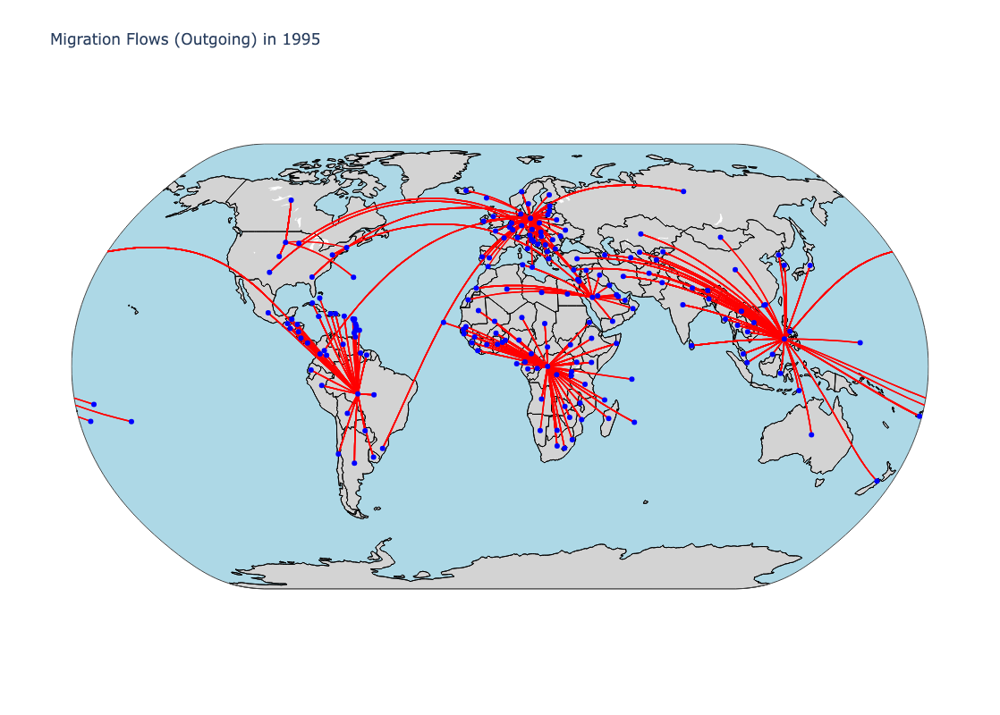

Generating map for Incoming flows in 2000...


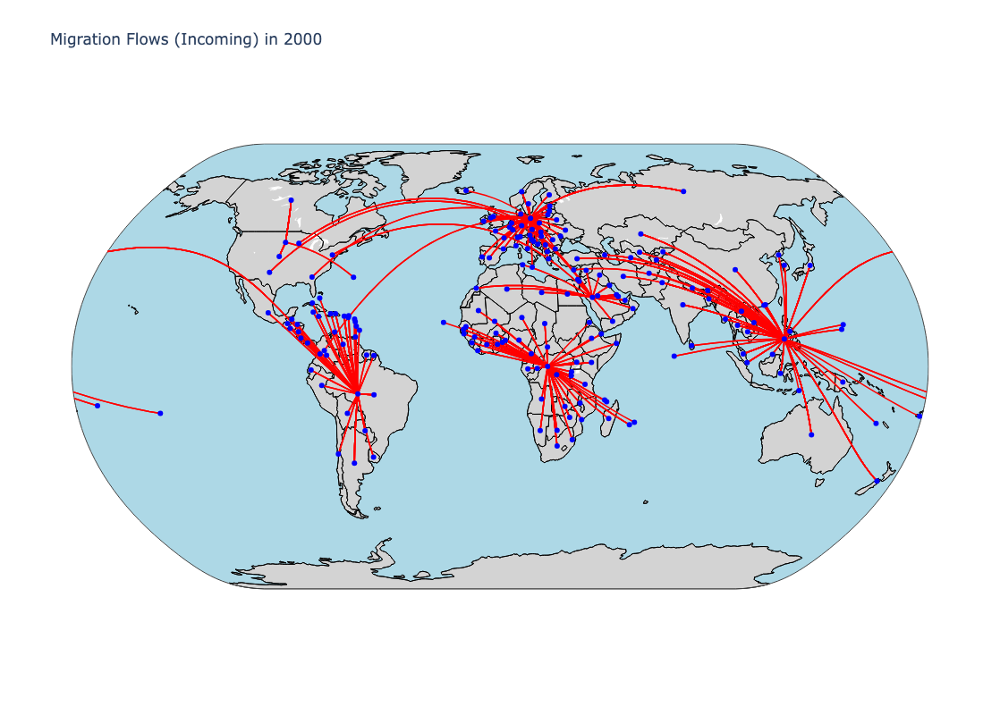

Generating map for Outgoing flows in 2000...


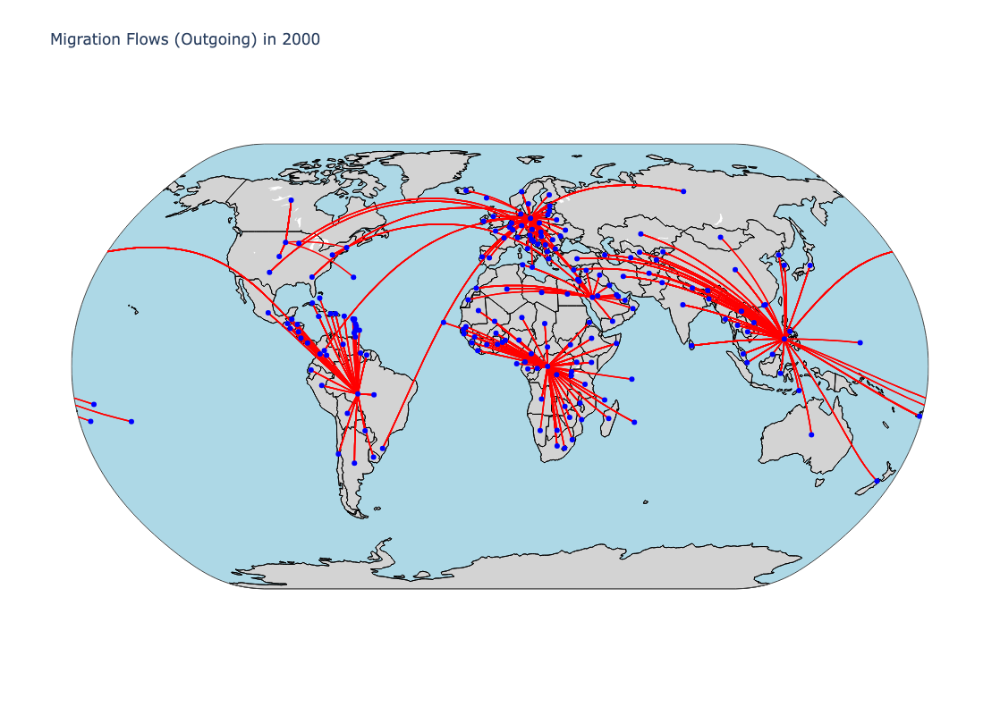

Generating map for Incoming flows in 2005...


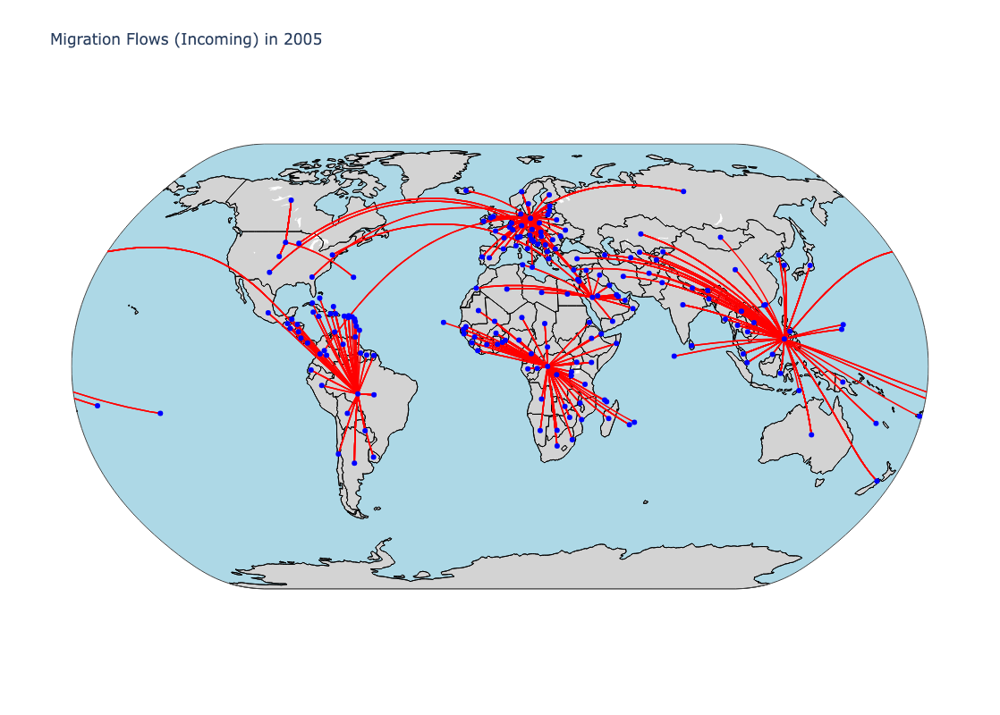

Generating map for Outgoing flows in 2005...


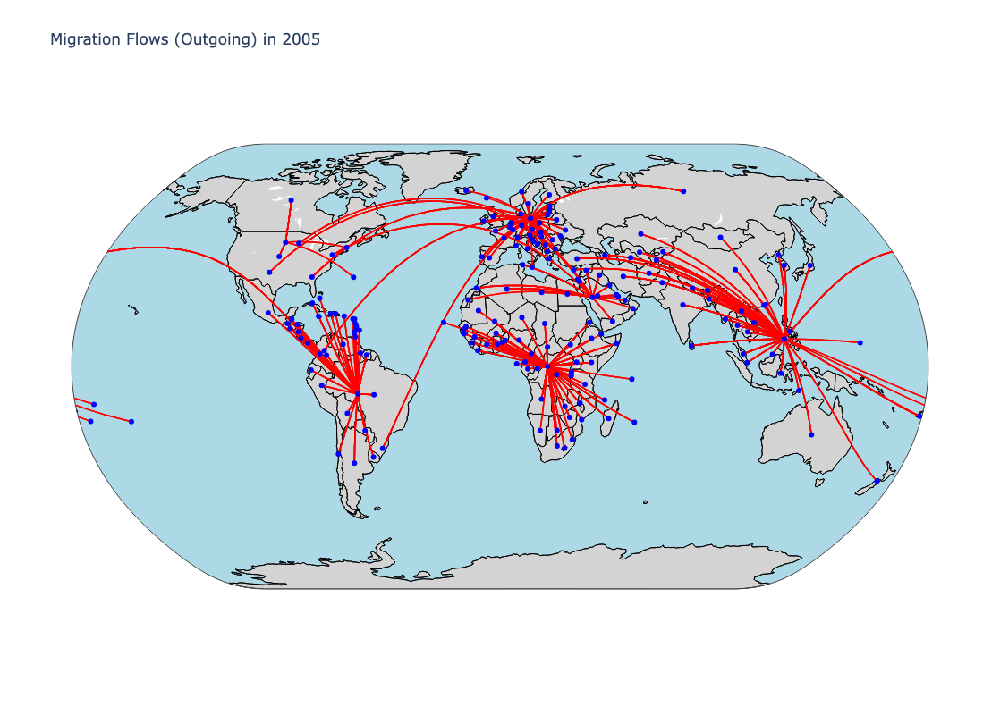

Generating map for Incoming flows in 2010...


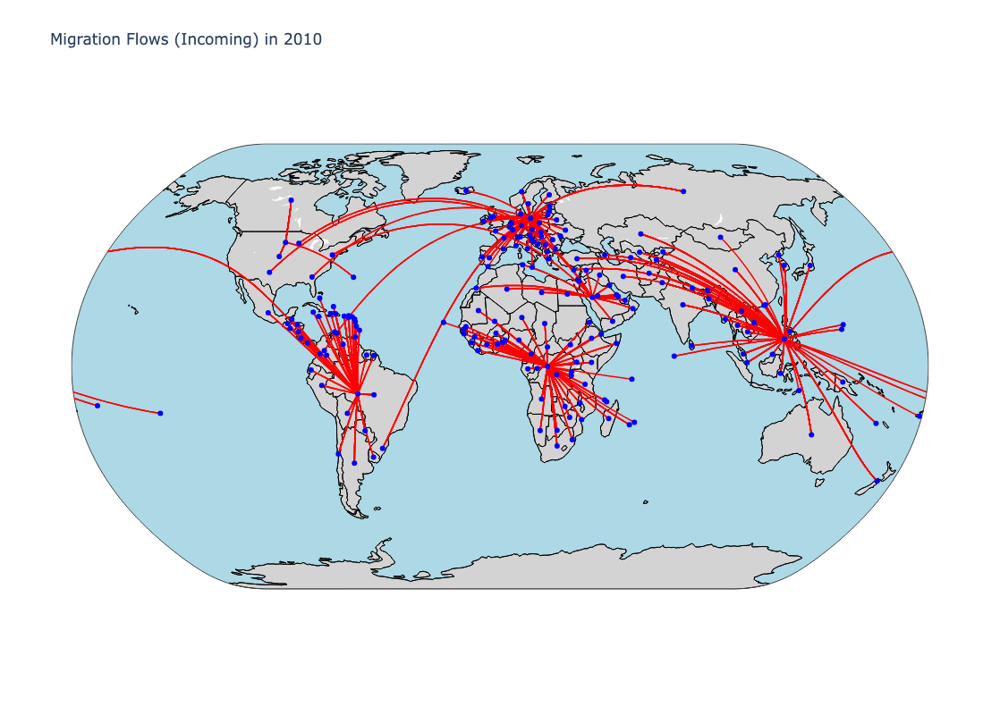

Generating map for Outgoing flows in 2010...


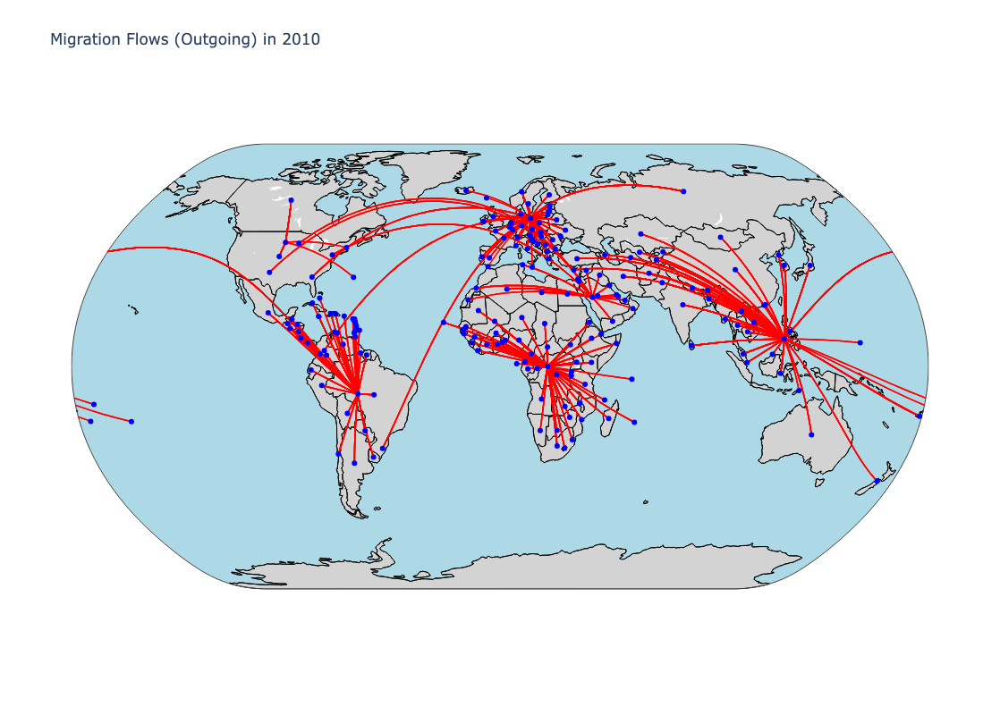

Generating map for Incoming flows in 2015...


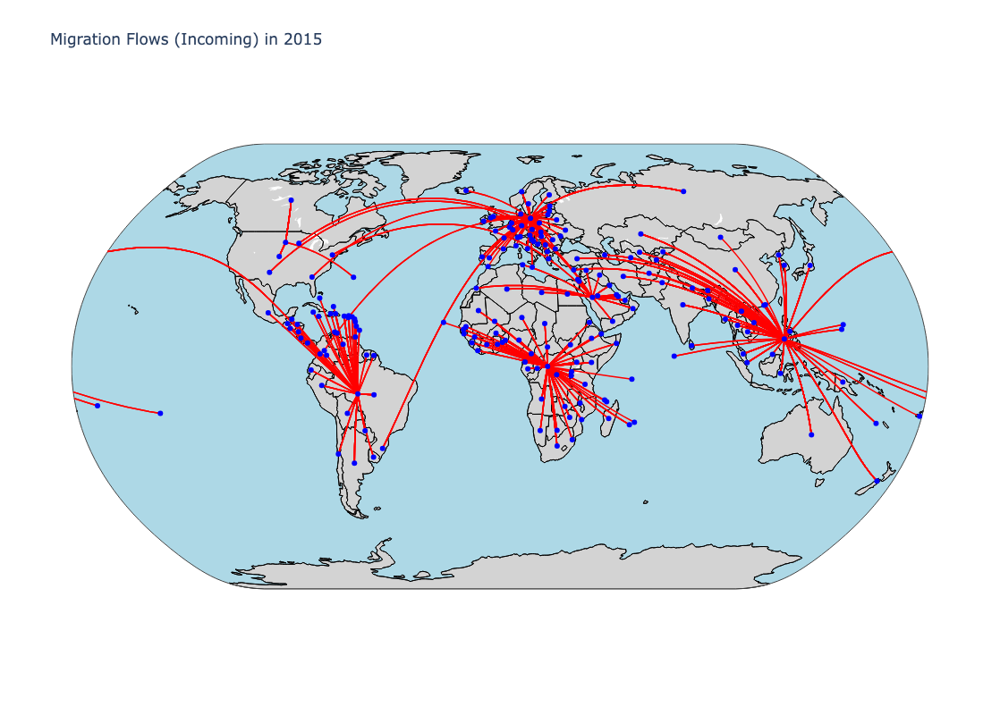

Generating map for Outgoing flows in 2015...


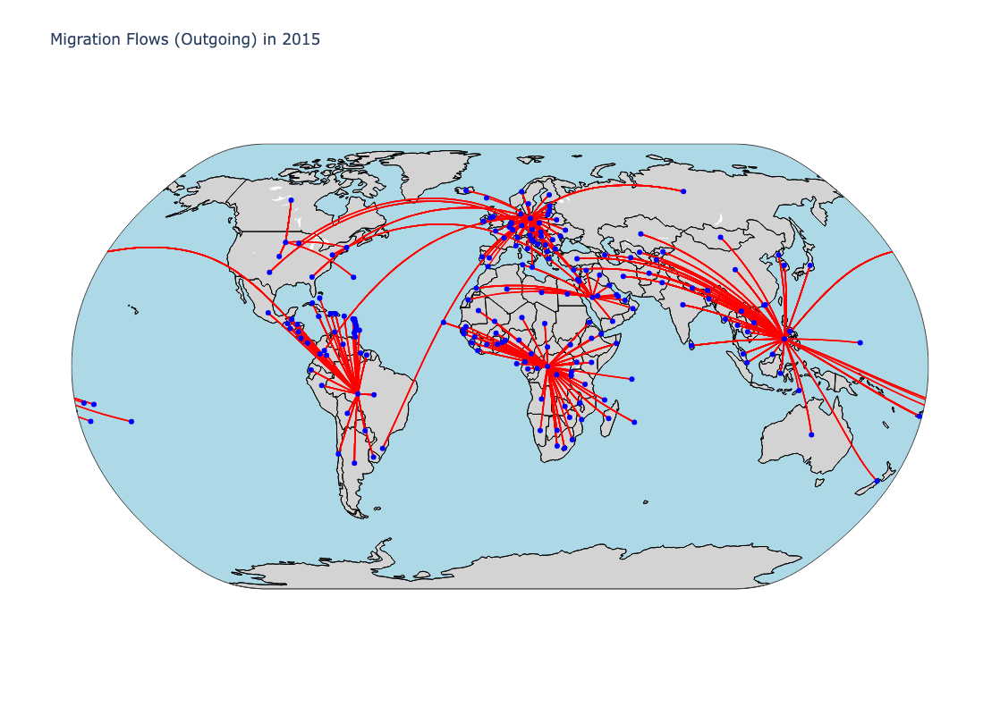

Generating map for Incoming flows in 2020...


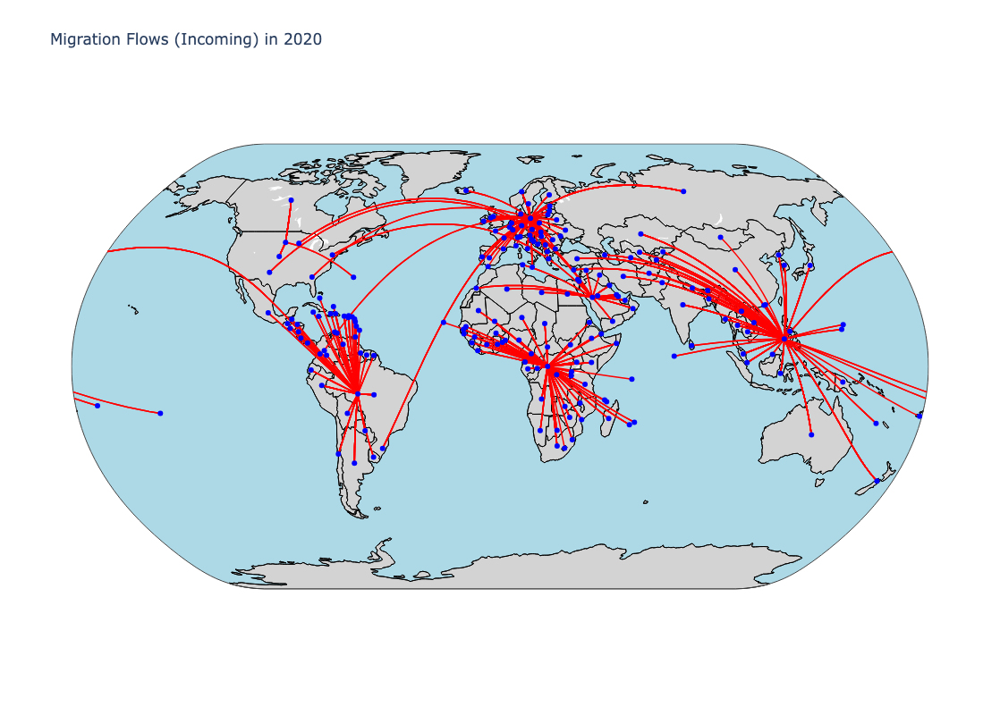

Generating map for Outgoing flows in 2020...


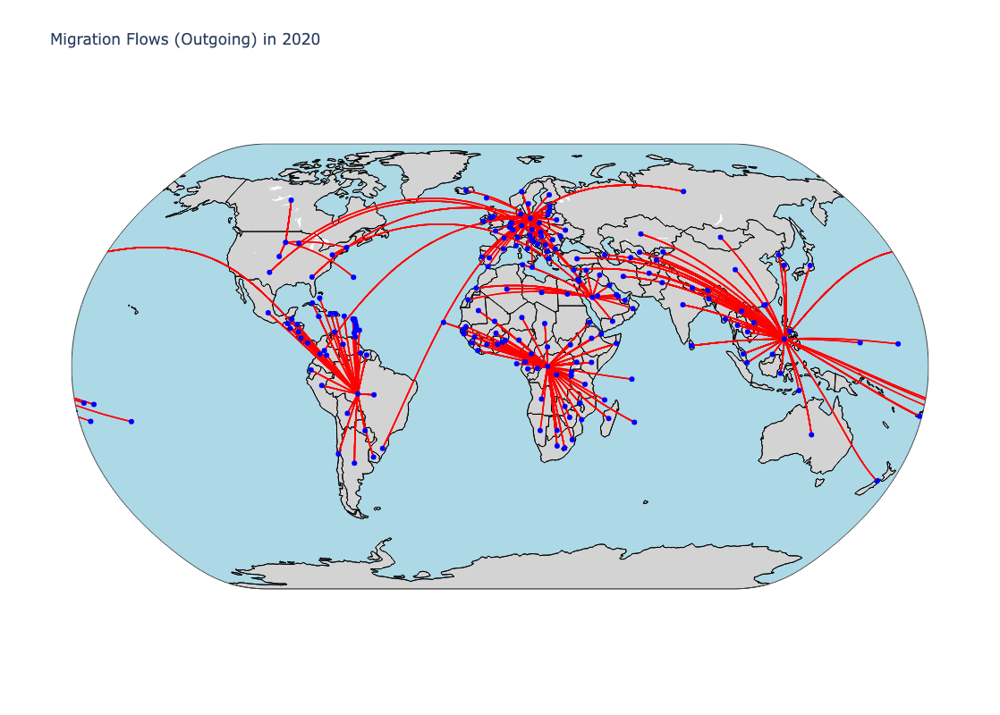

In [24]:
import pandas as pd
import plotly.graph_objects as go
from collections import defaultdict

# Predefined coordinates for regions
REGION_COORDINATES = {
    'All Asia-Pacific': (10, 120), 'Asia-Pacific': (10, 120),
    'All Europe': (54, 15), 'Europe': (54, 15),
    'All Latin America-Caribbean': (-10, -60), 'Latin America-Caribbean': (-10, -60),
    'All Middle East-North Africa': (25, 40), 'Middle East-North Africa': (25, 40),
    'All North America': (45, -100), 'North America': (45, -100),
    'All Sub-Saharan Africa': (0, 20), 'Sub-Saharan Africa': (0, 20),
}

def load_country_coordinates(coordinates_file):
    """
    Load country and region coordinates from a CSV file.

    Args:
        coordinates_file (str): Path to the coordinates file.

    Returns:
        dict: Dictionary mapping country/region names to (latitude, longitude).
    """
    coords_df = pd.read_csv(coordinates_file).dropna()
    country_coords = dict(zip(coords_df['Country'], zip(coords_df['Latitude'], coords_df['Longitude'])))
    country_coords.update(REGION_COORDINATES)
    return country_coords

def load_migration_data(migration_file):
    """
    Load and clean migration data from a CSV file.

    Args:
        migration_file (str): Path to the migration data file.

    Returns:
        DataFrame: Cleaned migration data.
    """
    df = pd.read_csv(migration_file, skiprows=1)
    df.columns = ['Direction', 'Year', 'Country', 'Religion', 'Count', 'Percent', 'Region', 'Level', 'CountryCode']
    df = df[~df['Region'].isin(['Unknown Origin', 'Global'])]  # Exclude unwanted rows
    df['Count'] = df['Count'].replace({',': ''}, regex=True)
    df['Count'] = pd.to_numeric(df['Count'], errors='coerce')
    df = df.dropna(subset=['Count'])
    return df

def plot_interactive_migration_flows(df, country_coords, year, direction):
    """
    Plot a single interactive migration flow map for a specific year and direction.

    Args:
        df (DataFrame): Migration data filtered by year and direction.
        country_coords (dict): Dictionary of country/region coordinates.
        year (int): The year of migration flows.
        direction (str): Direction of migration ('Incoming' or 'Outgoing').
    """
    filtered_df = df[(df['Year'] == year) & (df['Direction'] == direction)]

    if filtered_df.empty:
        print(f"No data found for year {year} and direction '{direction}'.")
        return

    # Data preparation
    flows = []
    aggregated_data = defaultdict(lambda: defaultdict(float))  # For summarizing by destination and religion
    points = set()

    for _, row in filtered_df.iterrows():
        destination = row['Country']
        origin = row['Region']
        religion = row['Religion']
        count = row['Count']

        origin_coords = country_coords.get(origin)
        dest_coords = country_coords.get(destination)

        if not origin_coords or not dest_coords:
            continue  # Skip if coordinates are missing

        # Add migration flow line
        flows.append({
            'origin_lat': origin_coords[0], 'origin_lon': origin_coords[1],
            'dest_lat': dest_coords[0], 'dest_lon': dest_coords[1],
            'destination': destination, 'origin': origin, 'religion': religion, 'count': count
        })

        # Aggregate for destination markers
        aggregated_data[destination]['total'] += count
        aggregated_data[destination][religion] += count
        points.add((dest_coords[0], dest_coords[1], destination))

    # Create the figure
    fig = go.Figure()

    # Add flows (lines with hover info)
    for flow in flows:
        fig.add_trace(go.Scattergeo(
            lon=[flow['origin_lon'], flow['dest_lon']],
            lat=[flow['origin_lat'], flow['dest_lat']],
            mode='lines',
            line=dict(width=1.5, color='red'),
            hoverinfo='text',
            text=(
                f"Origin: {flow['origin']}<br>"
                f"Destination: {flow['destination']}<br>"
                f"Religion: {flow['religion']}<br>"
                f"Migration Count: {flow['count']:,}"
            )
        ))

    # Add destination points with aggregated data
    for lat, lon, name in points:
        summary = aggregated_data[name]
        total_count = summary.pop('total')
        details = "<br>".join([f"{rel}: {cnt:,.0f}" for rel, cnt in summary.items()])
        fig.add_trace(go.Scattergeo(
            lon=[lon],
            lat=[lat],
            mode='markers',
            marker=dict(size=6, color='blue'),
            hoverinfo='text',
            text=(
                f"Country: {name}<br>"
                f"Total Migration: {total_count:,.0f}<br>"
                f"By Religion:<br>{details}"
            )
        ))

    # Update map layout
    fig.update_layout(
        title=f'Migration Flows ({direction}) in {year}',
        geo=dict(
            projection_type='natural earth',
            showland=True, landcolor='lightgray',
            showocean=True, oceancolor='lightblue',
            showcountries=True, countrycolor="black",
            coastlinecolor="black",
        ),
        height=800,
        width=1200,
        showlegend=False
    )

    fig.show()

def main():
    """
    Main function to generate interactive migration maps for all years and directions.
    """
    migration_file = 'Incoming and Outgoing Migrant Counts.csv'
    coordinates_file = 'country_coordinates.csv'

    # Load data
    country_coords = load_country_coordinates(coordinates_file)
    migration_df = load_migration_data(migration_file)

    # Get unique years and directions
    unique_years = migration_df['Year'].unique()
    directions = ['Incoming', 'Outgoing']

    # Generate maps for each year and direction
    for year in sorted(unique_years):
        for direction in directions:
            print(f"Generating map for {direction} flows in {year}...")
            plot_interactive_migration_flows(migration_df, country_coords, year, direction)

if __name__ == "__main__":
    main()

While these maps may not seem revolutionary, they offer the casual observer the opportunity to interact with the Pew dataset in a way that Pew itself does not. Namely, while Pew shared its findings with the media, it never provided the public with anything as intuitive as an interactive map. Were we to publish our maps online, members of the public could view them, engage with the underlying data without needing technical knowhow, and come to their own countries. In other words, they wouldn't have to rely on Pew or the media as a middleman.

The beauty of Python—and what we hope to illustrate with this final part of our project—is that we can use the knowledge that we gained from this course to make the complex simple. More specifically, we've turned a complicated dataset on a controversial issue into an easy-to-use series of maps. Moreover, we could easily share our code with Pew to use on its own website.

Our maps are hardly perfect. The categorization of some migration by region rather than by country, for instance, makes mapping a challenge. And oddly, the API that we used coded some countries in the wrong locations (Lebanon and Sudan, for example, were given coordinates in North America). But the underlying code is robust, and, most significantly, the result is useful well beyond the classroom.